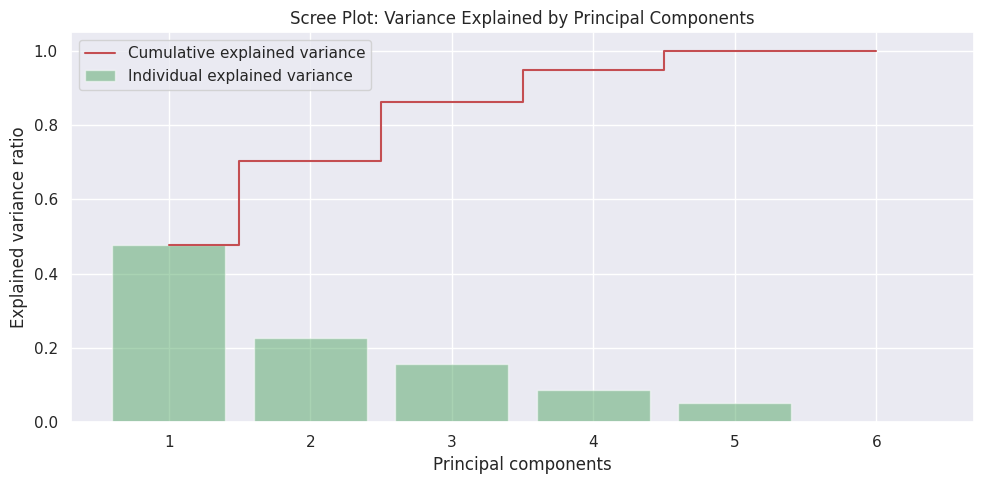

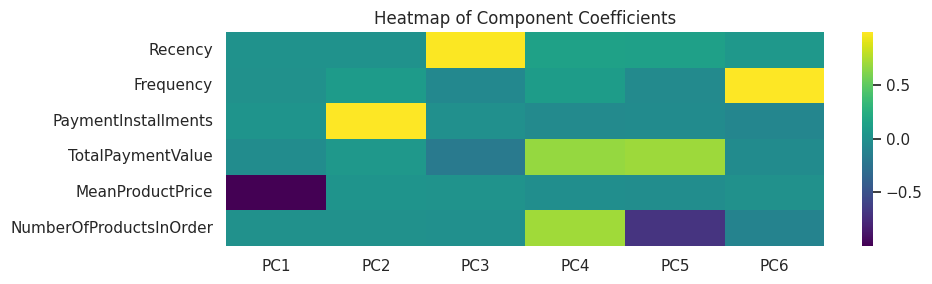

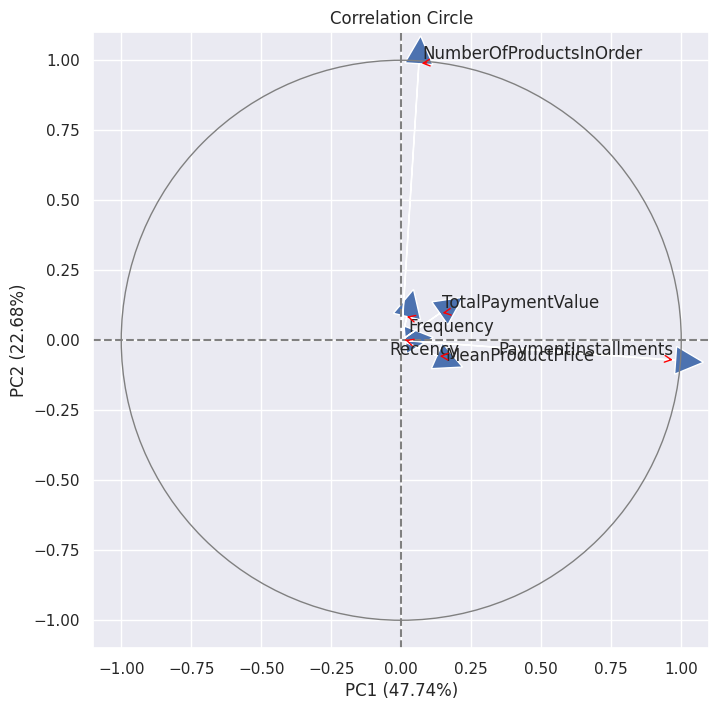

In [2]:
# Importing necessary libraries
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans, MiniBatchKMeans, DBSCAN, BisectingKMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score
from sklearn.preprocessing import LabelEncoder, StandardScaler, QuantileTransformer, MinMaxScaler

import plotly.express as px
from functions import optimize_kmeans, transform_columns, plot_correlation_circle, optimize_dbscan

import seaborn as sns

# Apply Seaborn's aesthetic parameters to match Matplotlib's style
sns.set()

# Set pandas display option for maximum columns
pd.set_option('display.max_columns', 50)

DATA_FILE = "/workspaces/OpenClassroom--Machine-Learning-Engineer/P4/data/data_cleaned.csv.gz"

RANDOM_STATE = 42
DROP_COLUMNS = ["CustomerID", "UniqueCustomerID", "CustomerZipCodePrefix", 
                "RecencyClass","OrderTimestamp", "FrequencyClass", 
                "OrderID", "TotalPaymentValueClass", 'CustomerCity',
                'CustomerState', 'OrderStatus','MeanFreightValue',
                'AverageProductWeightG', 'AverageProductLengthCM', 'AverageProductHeightCM',
                'AverageProductWidthCM',]



df = pd.read_csv(DATA_FILE)

df_transformed = transform_columns(df)
df_transformed  = df_transformed.drop(columns = DROP_COLUMNS)

plot_correlation_circle(df_transformed, dimension='2d')

In [3]:
kmeans_results = optimize_kmeans(df_transformed.values)
dbscan_results = optimize_dbscan(df_transformed.values)

kmeans_results_df = pd.DataFrame(kmeans_results).drop(columns="optimal_k")
kmeans_results_df["inertias"] = MinMaxScaler().fit_transform(kmeans_results_df["inertias"].values.reshape(-1, 1))

fig = px.line(kmeans_results_df.melt(id_vars="k_values"), 
        x = "k_values",
        y = "value",
        color="variable")

fig.show()

pca = PCA(n_components = 3, random_state = RANDOM_STATE).fit(df_transformed.values)
compressed_data = pca.transform(df_transformed.values)

In [5]:
kmeans_results = optimize_kmeans(df_transformed.values)

kmeans_results_df = pd.DataFrame(kmeans_results).drop(columns="optimal_k")
kmeans_results_df["inertias"] = MinMaxScaler().fit_transform(kmeans_results_df["inertias"].values.reshape(-1, 1))

fig = px.line(kmeans_results_df.melt(id_vars="k_values"), 
        x = "k_values",
        y = "value",
        color="variable")

fig.show()

In [ ]:
from sklearn.decomposition import PCA
from sklearn.cluster import HDBSCAN
km = KMeans(n_clusters=kmeans_results["optimal_k"], random_state=42, n_init="auto").fit(df_transformed.values)
pca = PCA(n_components=3, random_state=42).fit(df_transformed.values)
tmp = pca.transform(df_transformed.values)
tmp_df = pd.DataFrame({"labels": km.labels_, "dim 1": tmp[:, 0], "dim 2": tmp[:, 1], "dim 3": tmp[:, 2]})
tmp_df["labels"] = tmp_df["labels"].astype(str)
px.scatter(tmp_df, x="dim 1", y="dim 2", color="labels")

In [14]:
#kmeans_results["silhouette_scores"] = MinMaxScaler().fit_transform(kmeans_results["silhouette_scores"].values.reshape(-1, 1))
#kmeans_results["davies_bouldin_scores"] = MinMaxScaler().fit_transform(kmeans_results["davies_bouldin_scores"].values.reshape(-1, 1))


In [6]:
from sklearn.decomposition import PCA
from sklearn.cluster import HDBSCAN
km = KMeans(n_clusters=4, random_state=42, n_init="auto").fit(df_transformed.values)
bkm = BisectingKMeans(n_clusters=2, random_state=42).fit(df_transformed.values)
db = DBSCAN(eps=0.1, min_samples=10, n_jobs=-1).fit(df_transformed.values)
hbdb = HDBSCAN(n_jobs = -1).fit(df_transformed.values)

pca = PCA(n_components=2, random_state=42).fit(df_transformed.values)
#df[["Recency", "Frequency", "PaymentInstallments", "MeanProductPrice", "MeanFreightValue", "AverageProductWeightG", "AverageProductLengthCM", "AverageProductHeightCM", "AverageProductWidthCM", "NumberOfProductsInOrder"]].values

In [7]:
pca = PCA(n_components=3, random_state=42).fit(df_transformed.values)

In [16]:
pca.explained_variance_ratio_.sum()

0.9999924000703228

In [8]:
tmp = pca.transform(df_transformed.values)

In [ ]:
db.labels_

In [15]:
#tmp_df = pd.DataFrame({"labels": km.labels_, "dim 1": tmp[:, 0], "dim 2": tmp[:, 1]})
tmp_df = pd.DataFrame({"labels": hbdb.labels_, "dim 1": tmp[:, 0], "dim 2": tmp[:, 1], "dim 3": tmp[:, 2]})
tmp_df["labels"] = tmp_df["labels"].astype(str)

In [16]:
import plotly.express as px
px.scatter(tmp_df, x="dim 1", y="dim 2", color="labels")

In [17]:
px.scatter_3d(tmp_df, x="dim 1", y="dim 2",z="dim 3" ,color="labels")